ID: Unique identifier for the record.

Case Number: The Chicago Police Department RD Number (Records Division Number), 
which is unique to the incident.

Date: Date when the incident occurred. this is sometimes a best estimate.

Block: The partially redacted address where the incident occurred, placing it on the same block as the actual address.

IUCR: The Illinois Unifrom Crime Reporting code. This is directly linked to the Primary Type and Description. See the list of IUCR codes at https://data.cityofchicago.org/d/c7ck-438e.

Primary Type: The primary description of the IUCR code.

Description: The secondary description of the IUCR code, a subcategory of the primary description.

Location Description: Description of the location where the incident occurred.

Arrest: Indicates whether an arrest was made.

Domestic: Indicates whether the incident was domestic-related as defined by the 
Illinois Domestic Violence Act.

Beat: Indicates the beat where the incident occurred. A beat is the smallest police geographic area – each beat has a dedicated police beat car. Three to five beats make up a police sector, and three sectors make up a police district. The Chicago Police Department has 22 police districts. See the beats at https://data.cityofchicago.org/d/aerh-rz74.

District: Indicates the police district where the incident occurred. See the districts at https://data.cityofchicago.org/d/fthy-xz3r.

Ward: The ward (City Council district) where the incident occurred. See the wards at https://data.cityofchicago.org/d/sp34-6z76.

Community Area: Indicates the community area where the incident occurred. Chicago has 77 community areas. See the community areas at https://data.cityofchicago.org/d/cauq-8yn6.

FBI Code: Indicates the crime classification as outlined in the FBI's National Incident-Based Reporting System (NIBRS). See the Chicago Police Department listing of these classifications at http://gis.chicagopolice.org/clearmap_crime_sums/crime_types.html.


Year: Year the incident occurred.

Updated On: Date and time the record was last updated.

Latitude: The latitude of the location where the incident occurred. This location is shifted from the actual location for partial redaction but falls on 
the same block.

Longitude: The longitude of the location where the incident occurred. This location is shifted from the actual location for partial redaction but falls on the same block.

Location: The location where the incident occurred in a format that allows for creation of maps and other geographic operations on the data portal. This location is shifted from the actual location for partial redaction but falls on the same block. (don’t use this field)


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib 
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from google.colab import drive
from datetime import datetime
import sklearn.metrics as metrics
import folium


#to do: load data

drive.mount('/content/drive')

data = pd.read_csv('/content/drive/My Drive/Crimes___2017_to_Present.csv')


Mounted at /content/drive


In [ ]:
data.describe

#Data Cleaning

In [ ]:
data

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,Year,Updated On,Latitude,Longitude
0,11646166,JC213529,2018-09-01T00:01:00+0000,082XX S INGLESIDE AVE,0810,THEFT,OVER $500,RESIDENCE,False,True,631,6.0,8.0,44.0,06,2018,04/06/2019 04:04:43 PM,NaN,NaN
1,12014684,JD189901,2020-03-17T21:30:00+0000,039XX N LECLAIRE AVE,0820,THEFT,$500 AND UNDER,STREET,False,False,1634,16.0,45.0,15.0,06,2020,03/25/2020 03:45:43 PM,41.952052,-87.754660
2,11645648,JC212959,2018-01-01T08:00:00+0000,024XX N MONITOR AVE,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,RESIDENCE,False,False,2515,25.0,30.0,19.0,11,2018,04/06/2019 04:04:43 PM,NaN,NaN
3,11864018,JC476123,2019-09-24T08:00:00+0000,022XX S MICHIGAN AVE,1154,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT $300 AND UNDER,COMMERCIAL / BUSINESS OFFICE,False,False,132,1.0,3.0,33.0,11,2019,10/20/2019 03:56:02 PM,41.852248,-87.623786
4,11859805,JC471592,2019-10-13T20:30:00+0000,024XX W CHICAGO AVE,0860,THEFT,RETAIL THEFT,GROCERY FOOD STORE,False,False,1221,12.0,26.0,24.0,06,2019,10/20/2019 04:03:03 PM,41.895732,-87.687784
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1522310,12847575,JF420478,2022-09-01T05:00:00+0000,005XX W SURF ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,RESIDENCE,False,True,1934,19.0,44.0,6.0,26,2022,01/03/2023 03:46:28 PM,41.934305,-87.641485
1522311,12847801,JF420319,2022-07-08T00:00:00+0000,114XX S PRAIRIE AVE,1130,DECEPTIVE PRACTICE,FRAUD OR CONFIDENCE GAME,STREET,False,False,531,5.0,9.0,49.0,11,2022,01/03/2023 03:46:28 PM,41.685544,-87.616813
1522312,12847324,JF420102,2022-09-27T11:00:00+0000,023XX E 70TH ST,0810,THEFT,OVER $500,RESIDENCE,False,False,331,3.0,5.0,43.0,06,2022,01/03/2023 03:46:28 PM,41.768068,-87.567453
1522313,12847570,JF420427,2022-09-03T10:25:00+0000,052XX W CARMEN AVE,2021,NARCOTICS,POSSESS - BARBITURATES,RESIDENCE - YARD (FRONT / BACK),True,False,1623,16.0,45.0,11.0,18,2022,01/03/2023 03:46:28 PM,41.973391,-87.758535


In [ ]:
data.isna().sum()

ID                          0
Case Number                 0
Date                        0
Block                       0
IUCR                        0
Primary Type                0
Description                 0
Location Description     6831
Arrest                      0
Domestic                    0
Beat                        0
District                    1
Ward                       51
Community Area              1
FBI Code                    0
Year                        0
Updated On                  0
Latitude                25903
Longitude               25903
dtype: int64

In [ ]:
data=data.dropna()

In [ ]:
data.isna().sum()

ID                      0
Case Number             0
Date                    0
Block                   0
IUCR                    0
Primary Type            0
Description             0
Location Description    0
Arrest                  0
Domestic                0
Beat                    0
District                0
Ward                    0
Community Area          0
FBI Code                0
Year                    0
Updated On              0
Latitude                0
Longitude               0
dtype: int64

In [ ]:
#tirar o mes de abril
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%dT%H:%M')
data = data[(data['Year'] != 2023) | (data['Date'].dt.month != 4)]
data

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,Year,Updated On,Latitude,Longitude
1,12014684,JD189901,2020-03-17 21:30:00+00:00,039XX N LECLAIRE AVE,0820,THEFT,$500 AND UNDER,STREET,False,False,1634,16.0,45.0,15.0,06,2020,03/25/2020 03:45:43 PM,41.952052,-87.754660
3,11864018,JC476123,2019-09-24 08:00:00+00:00,022XX S MICHIGAN AVE,1154,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT $300 AND UNDER,COMMERCIAL / BUSINESS OFFICE,False,False,132,1.0,3.0,33.0,11,2019,10/20/2019 03:56:02 PM,41.852248,-87.623786
4,11859805,JC471592,2019-10-13 20:30:00+00:00,024XX W CHICAGO AVE,0860,THEFT,RETAIL THEFT,GROCERY FOOD STORE,False,False,1221,12.0,26.0,24.0,06,2019,10/20/2019 04:03:03 PM,41.895732,-87.687784
5,12571973,JE482457,2021-12-19 07:23:00+00:00,042XX S MOZART ST,0460,BATTERY,SIMPLE,SIDEWALK,True,True,921,9.0,15.0,58.0,08B,2021,09/12/2022 04:45:45 PM,41.816657,-87.695689
9,12012127,JD189186,2020-03-18 02:03:00+00:00,039XX W JACKSON BLVD,0910,MOTOR VEHICLE THEFT,AUTOMOBILE,APARTMENT,False,True,1132,11.0,28.0,26.0,07,2020,03/25/2020 03:47:29 PM,41.877110,-87.723990
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1522310,12847575,JF420478,2022-09-01 05:00:00+00:00,005XX W SURF ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,RESIDENCE,False,True,1934,19.0,44.0,6.0,26,2022,01/03/2023 03:46:28 PM,41.934305,-87.641485
1522311,12847801,JF420319,2022-07-08 00:00:00+00:00,114XX S PRAIRIE AVE,1130,DECEPTIVE PRACTICE,FRAUD OR CONFIDENCE GAME,STREET,False,False,531,5.0,9.0,49.0,11,2022,01/03/2023 03:46:28 PM,41.685544,-87.616813
1522312,12847324,JF420102,2022-09-27 11:00:00+00:00,023XX E 70TH ST,0810,THEFT,OVER $500,RESIDENCE,False,False,331,3.0,5.0,43.0,06,2022,01/03/2023 03:46:28 PM,41.768068,-87.567453
1522313,12847570,JF420427,2022-09-03 10:25:00+00:00,052XX W CARMEN AVE,2021,NARCOTICS,POSSESS - BARBITURATES,RESIDENCE - YARD (FRONT / BACK),True,False,1623,16.0,45.0,11.0,18,2022,01/03/2023 03:46:28 PM,41.973391,-87.758535


In [ ]:
import pandas as pd
from datetime import datetime

# Define sample timestamp
date = data.loc[:, 'Date']
df = pd.DataFrame(date)


# Define function to extract timestamp features
def extract_timestamp_features(timestamp):
    dt_obj=datetime.strptime(str(timestamp), '%Y-%m-%d %H:%M:%S%z')
    #dt_obj = datetime.strptime(timestamp, '%Y-%m-%dT%H:%M:%S%z')
    day = dt_obj.day
    month = dt_obj.month
    if dt_obj.hour < 6 or dt_obj.hour >= 20:
        part_of_day = 'night'
    elif dt_obj.hour < 12:
        part_of_day = 'morning'
    else:
        part_of_day = 'afternoon'
    day_of_week = dt_obj.strftime('%A')
    return (day, month, part_of_day, day_of_week)

# Apply function to timestamp column to extract features
df[['day', 'month', 'part_of_day', 'day_of_week']] = df['Date'].apply(lambda x: pd.Series(extract_timestamp_features(x)))

data_clean = data.join(df[['day', 'month', 'part_of_day', 'day_of_week']])



In [ ]:
# select rows that don't contain the value 'x'
filtered_df = data_clean[data_clean['District'] != 31.0]

# assign the filtered DataFrame back to the original column
data_clean['District'] = filtered_df['District']

In [ ]:
data_clean['District_Cat'] = np.where(data_clean['District'].isin([11,14,15,16,17,19,20,24,25]), 'north', np.where(data_clean['District'].isin([1,2,3,8,9,10,12,13,18]), 'central', 'south'))


In [ ]:
#from google.colab import files

#data_clean.to_csv('data_clean.csv', encoding = 'utf-8-sig') 
#files.download('data_clean.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Correlation

<ipython-input-10-402347ec8f47>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(data.corr(),cmap='YlGnBu', annot=True)


<Axes: >

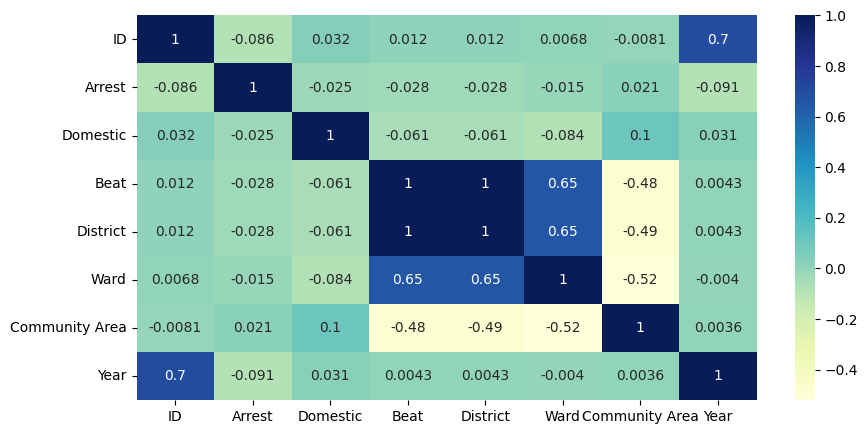

In [ ]:
fig, ax = plt.subplots(figsize=(10, 5))  
sns.heatmap(data.corr(),cmap='YlGnBu', annot=True) 

# Graphics



In [ ]:
data = data.drop(['FBI Code'],axis=1)

In [ ]:
data['Month']= data['Date'].dt.month

In [ ]:
data['location']="("+data['Latitude'].astype(str)+","+data['Longitude'].astype(str)+")"


In [ ]:
unique_location = data['location'].value_counts()
unique_location.index

Index(['(41.883500187,-87.627876698)', '(41.976290414,-87.905227221)',
       '(41.754592961,-87.741528537)', '(41.868541914,-87.639235361)',
       '(41.868180939,-87.709271389)', '(41.897895128,-87.624096605)',
       '(41.788987036,-87.74147999)', '(41.976762981,-87.900983721)',
       '(41.742710224,-87.634088181)', '(41.891694878,-87.626155832)',
       ...
       '(41.962842405,-87.721875604)', '(41.728874612,-87.597369178)',
       '(41.992549286,-87.7128364)', '(41.944594667,-87.724181955)',
       '(41.915050636,-87.764360022)', '(41.754554499,-87.626886337)',
       '(41.90370259,-87.644034217)', '(41.88747417,-87.716087141)',
       '(41.918838556,-87.655820204)', '(41.973391184,-87.758534512)'],
      dtype='object', length=360823)

In [ ]:
#creating a new dataframe which consists of latitude and longitude and sorted according the number of crimes happened on that location
new_unique_location = pd.DataFrame({'Raw String' : unique_location.index, 'Values Count': unique_location})
new_unique_location.index = range(len(unique_location))
new_unique_location.head()

,Raw String,Values Count
0,"(41.883500187,-87.627876698)",2322
1,"(41.976290414,-87.905227221)",1643
2,"(41.754592961,-87.741528537)",1291
3,"(41.868541914,-87.639235361)",1111
4,"(41.868180939,-87.709271389)",1087


In [ ]:
#as our locatioin is in form of string so creating a function for extracing out the latitude and longitude
def location_extractor(string):
    
    values = string[1:-1].split(',')
    lat, long = values[0], values[1]
    
    return lat, long

In [ ]:
#creating the new dataframe which comsists of the latitude and longitude in sorted on the basis of the number of crimes had happened
new_unique_location['Location Coord'] = new_unique_location['Raw String'].apply(location_extractor)
new_unique_location = new_unique_location.drop('Raw String', axis = 1)
new_unique_location.head()

,Values Count,Location Coord
0,2322,"(41.883500187, -87.627876698)"
1,1643,"(41.976290414, -87.905227221)"
2,1291,"(41.754592961, -87.741528537)"
3,1111,"(41.868541914, -87.639235361)"
4,1087,"(41.868180939, -87.709271389)"


In [ ]:
#creating a new map
chicago_crime_map = folium.Map(location = [41.883500187, -87.627876698], zoom_start = 10, tiles = 'CartoDB dark_matter')


In [ ]:
#plotting circles on map a larger and red circle represent large number of crimes while a smaller blue circle represent the less number of crimes
for i in range(500):
    
    #extracting latitude
    lat = float(new_unique_location['Location Coord'].iloc[i][0])
    
    #extracting longitude
    long = float(new_unique_location['Location Coord'].iloc[i][1])
    
    #making radius dynamic on the basis of number of crimes
    radius = float(new_unique_location['Values Count'].iloc[i]) / 40
    
    # if number of crimes are more than 1000 then circle will be red in color else blue in color 
    if float(new_unique_location["Values Count"].iloc[i]) > 1000:
        color = '#FF4500'
    else:
        color = '#008080'
        
    #creating the popup text which will show Latitude, Longitude and Number of crimes happened on place when clicked on Map
    popup_text = """Latitude : {}<br><br>
                    Longitude : {}<br><br>
                    No of Crime Incident : {}<br><br>"""
    
    popup_text = popup_text.format(lat, long, new_unique_location['Values Count'][i])
    
    
    #drawing circles on map with different color and dynamic radius
    folium.CircleMarker(location = [lat, long], radius = radius, color = color, popup = popup_text, fill = True).add_to(chicago_crime_map)

In [ ]:
chicago_crime_map

In [ ]:
Num_crimes_type = data['Primary Type'].value_counts()
Num_crimes_type.values

array([334076, 280303, 166318, 124250, 100102,  94696,  79131,  58868,
        56396,  55956,  44532,  33401,  12605,   7119,   6627,   5440,
         5317,   4227,   3732,   2869,   2824,   1689,   1261,   1007,
          978,    879,    583,    371,     85,     63,     54,     34,
            5,      1])

In [ ]:
Num_crimes_type = data['Primary Type'].value_counts()
type = pd.DataFrame(data=Num_crimes_type.index, columns=["Primary Type"])
type['values'] = Num_crimes_type.values

In [ ]:
import plotly.express as px
fig = px.pie(type[:10], values='values', names='Primary Type', title='Top 10 Crime Type', color_discrete_sequence=px.colors.sequential.RdBu)
fig.show()

In [ ]:
fig = px.histogram(data, x='Year',color='Primary Type')
fig.update_layout(
        title_text='Chicago Type of Crime by Year',
        xaxis_title_text='Crime', 
        yaxis_title_text='Count', 
        bargap=0.2, 
        bargroupgap=0.1
    )
fig.show()

In [ ]:
data['Hour']=data['Date'].dt.hour

In [ ]:
# for year 2020
data_2018= data[data['Year']==2020]

fig = px.histogram(data_2018, x='Month',color='Primary Type')
fig.update_layout(
        title_text='Chicago Type of Crime by Month in 2020',
        xaxis_title_text='Crime', 
        yaxis_title_text='Count', 
        bargap=0.2, 
        bargroupgap=0.1
    )
fig.show()

In [ ]:
# for year 2020
data_2018= data[data['Year']==2020]
data['Primary Type'].value_counts()
fig = px.histogram(data_2018, x='Hour',color='Primary Type')
fig.update_layout(
        title_text='Chicago Type of Crime by Hour',
        xaxis_title_text='Crime', 
        yaxis_title_text='Count', 
        bargap=0.2, 
        bargroupgap=0.1
    )
fig.show()

In [ ]:
# for year 2019
data_2018= data[data['Year']==2019]
data['Primary Type'].value_counts()
fig = px.histogram(data_2018, x='Hour',color='Primary Type')
fig.update_layout(
        title_text='Chicago Type of Crime by Hour',
        xaxis_title_text='Crime', 
        yaxis_title_text='Count', 
        bargap=0.2, 
        bargroupgap=0.1
    )
fig.show()

<Axes: xlabel='count', ylabel='Location Description'>

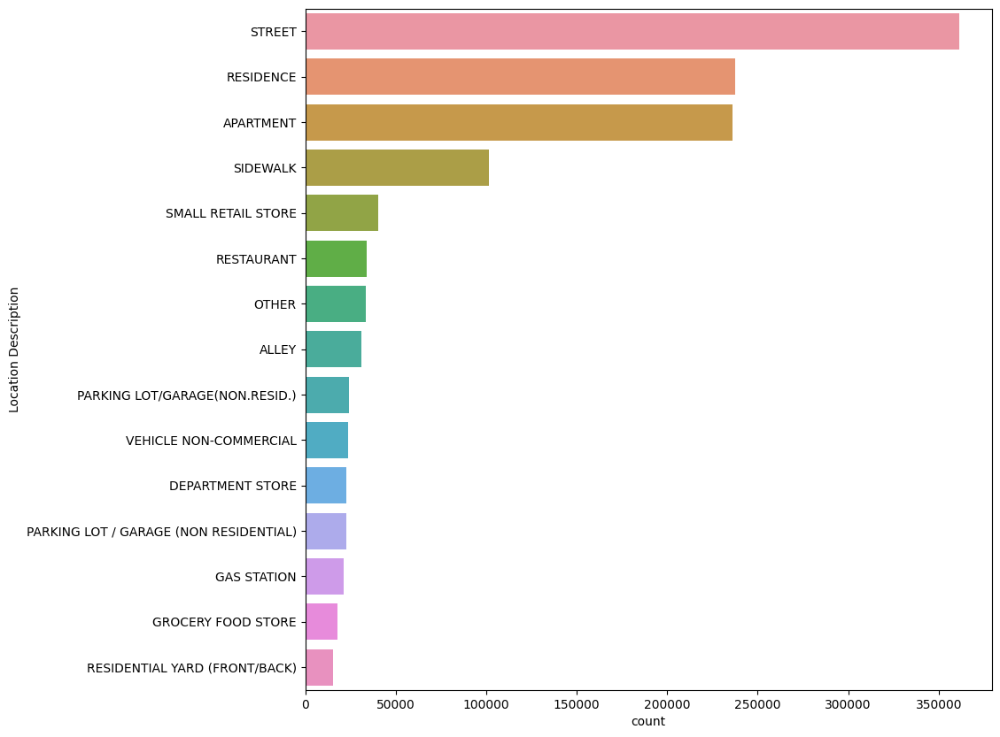

In [ ]:
#plotting top 15 crime types 
plt.figure(figsize = (10, 10))
sns.countplot(y = 'Location Description', data = data, order = data['Location Description'].value_counts().iloc[:15].index)

In [ ]:
#creating a new dataframe which consists of description sorted on the basis of their number
new_data_theft = pd.DataFrame({'Counts' : data['Description'].value_counts(), 'Description' : data['Description'].value_counts().index})
new_data_theft.reset_index(inplace=True)
new_data_theft = new_data_theft.drop(columns = ['index'], axis = 1)
new_data_theft.head()

,Counts,Description
0,170050,SIMPLE
1,134770,DOMESTIC BATTERY SIMPLE
2,126625,$500 AND UNDER
3,91284,OVER $500
4,83092,TO VEHICLE


<Axes: xlabel='count', ylabel='Description'>

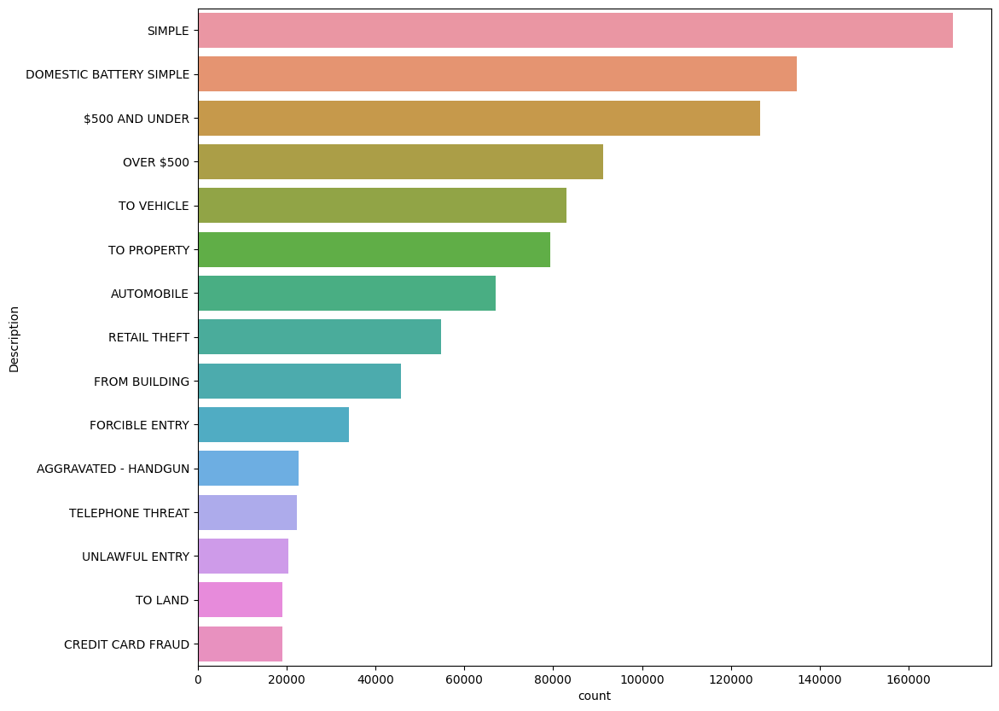

In [ ]:
#drawing the bar plot with description on y axis while number of times that happened on x axis
plt.figure(figsize = (12, 10))
#sns.barplot(y = 'Description', x = 'Counts', data = new_data_theft, palette="jet_r")
sns.countplot(y = 'Description', data = data, order = data['Description'].value_counts().iloc[:15].index)

<Axes: xlabel='Counts', ylabel='Description'>

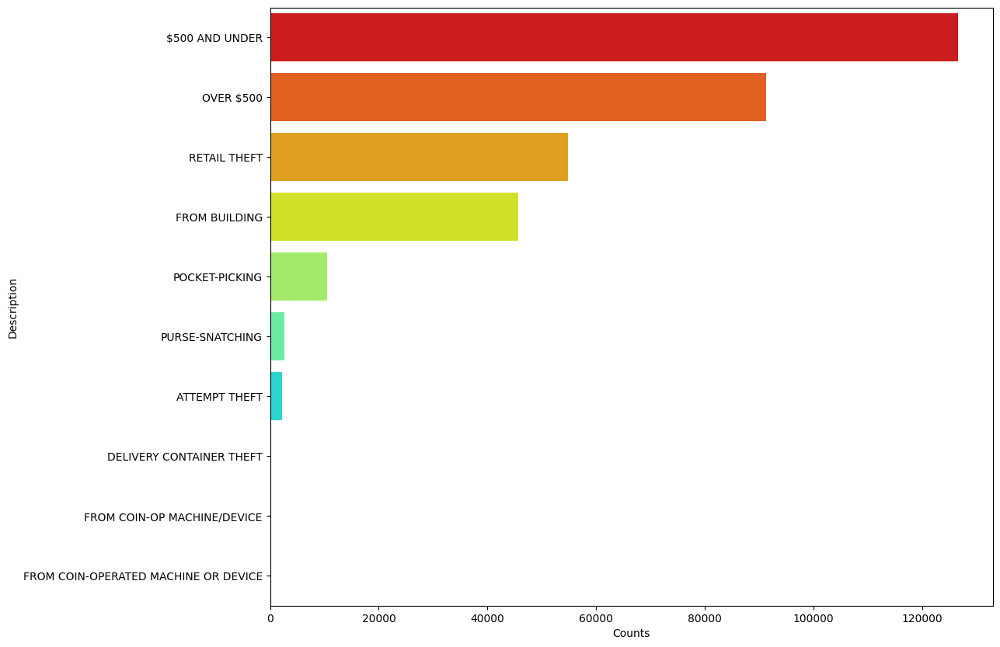

In [ ]:
data_theft = data[data['Primary Type'] == 'THEFT']
#creating a new dataframe which consists of description sorted on the basis of their number
new_data_theft = pd.DataFrame({'Counts' : data_theft['Description'].value_counts(), 'Description' : data_theft['Description'].value_counts().index})
new_data_theft.reset_index(inplace=True)
new_data_theft = new_data_theft.drop(columns = ['index'], axis = 1)
new_data_theft.head()
#drawing the bar plot with description on y axis while number of times that happened on x axis
plt.figure(figsize = (12, 10))
sns.barplot(y = 'Description', x = 'Counts', data = new_data_theft, palette="jet_r")

In [ ]:
import plotly.express as px

fig = px.histogram(data_clean, x='day_of_week',color='Primary Type')
fig.update_layout(
        title_text='Chicago Type of Crime by Day of Week',
        xaxis_title_text='Crime', 
        yaxis_title_text='Count', 
        bargap=0.2, 
        bargroupgap=0.1
    )
fig.show()

In [ ]:
data['District'].value_counts().sort_index()

In [ ]:
data_clean['District'].value_counts().sort_index()